In [73]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random

In [74]:
base_model = tf.keras.applications.InceptionV3(include_top = False,
                                              weights = 'imagenet')

In [75]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d_188 (Conv2D)         (None, None, None, 32)       864       ['input_3[0][0]']             
                                                                                                  
 batch_normalization_188 (B  (None, None, None, 32)       96        ['conv2d_188[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_188 (Activation  (None, None, None, 32)       0         ['batch_normalizati

In [ ]:
# names = ['mixed8', 'mixed9']
# names = ['mixed3', 'mixed5', 'mixed8', 'mixed9']
names = ['mixed3', 'mixed5']
# names = ['mixed5']

In [ ]:
layers = [base_model.get_layer(name).output for name in names]

In [ ]:
layers

In [ ]:
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

# Data processing

In [80]:
sample_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))

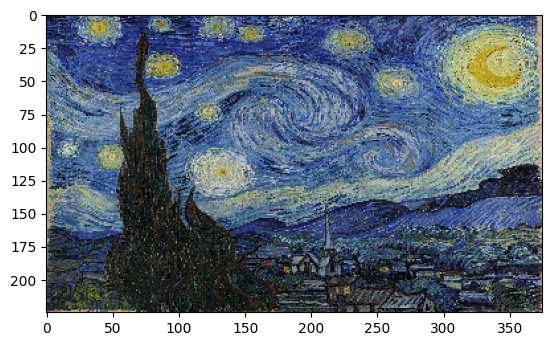

In [81]:
plt.imshow(sample_image)

In [82]:
type(sample_image)

PIL.Image.Image

In [83]:
sample_image = np.array(sample_image) / 255.0


In [84]:
sample_image.shape

(225, 375, 3)

In [85]:
type(sample_image)

numpy.ndarray

In [86]:
sample_image.max()

1.0

In [87]:
sample_image.min()

0.0

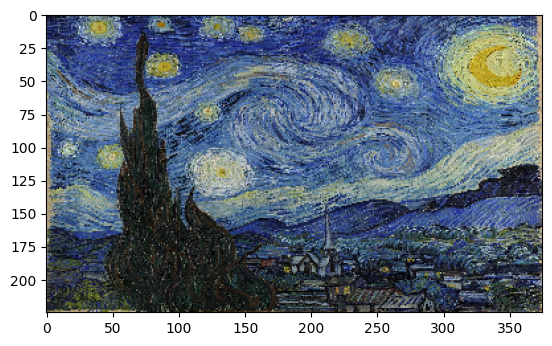

In [88]:
plt.imshow(sample_image)

In [89]:
sample_image = tf.keras.preprocessing.image.img_to_array(sample_image)
sample_image.shape

(225, 375, 3)

In [90]:
type(sample_image)

numpy.ndarray

# Model

In [91]:
sample_image = tf.Variable(tf.keras.applications.inception_v3.preprocess_input(sample_image))

In [92]:
type(sample_image)

tensorflow.python.ops.resource_variable_ops.ResourceVariable

In [93]:
sample_image = tf.expand_dims(sample_image, axis = 0)
sample_image.shape

TensorShape([1, 225, 375, 3])

In [94]:
activations = deepdream_model(sample_image)

In [95]:
len(activations)

4

In [96]:
activations[0]

<tf.Tensor: shape=(1, 12, 21, 768), dtype=float32, numpy=
array([[[[0.        , 0.6236413 , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.63640016, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.02043545, 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],

        [[0.        , 0.00481814, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.1344443 , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.      

# Loss function

In [124]:
def calc_loss(image, model, test = 1):
  if test == 1:
    img_batch = tf.expand_dims(image, axis = 0)
    layer_activations = model(img_batch)
  else:
    layer_activations = model(image)

  losses = []

  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  print("Lossess from multiple activatin layers = ", losses)
  #print("Losses shape = ", np.shape(losses))
  print("Sum of losses = ", tf.reduce_sum(losses))
  return tf.reduce_sum(losses)

In [125]:
loss = calc_loss(sample_image, deepdream_model, test = 0)
loss

Lossess from multiple activatin layers =  [<tf.Tensor: shape=(), dtype=float32, numpy=0.26344284>, <tf.Tensor: shape=(), dtype=float32, numpy=0.17727819>, <tf.Tensor: shape=(), dtype=float32, numpy=0.14142303>, <tf.Tensor: shape=(), dtype=float32, numpy=0.051414963>]
Sum of losses =  tf.Tensor(0.63355905, shape=(), dtype=float32)


<tf.Tensor: shape=(), dtype=float32, numpy=0.63355905>

# Gradient

In [126]:
@tf.function
def deepdream(model, image, step_size):
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss = calc_loss(image, model)

  gradients = tape.gradient(loss, image)
  gradients /= tf.math.reduce_std(gradients)
  image = image + step_size * gradients
  image = tf.clip_by_value(image, -1, 1)
  return loss, image

In [127]:
def deprocess(img):
  img = 255 * (img + 1.0) / 2.0
  return tf.cast(img, tf.uint8)

In [128]:
def run_deepdream_simple(model, image, steps = 100, step_size = 0.01):
  image = tf.keras.applications.inception_v3.preprocess_input(image)
  for step in range(steps):
    loss, image = deepdream(model, image, step_size)

    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print("Step {}, loss {}".format(step, loss))

  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

Test

In [132]:
test_image = tf.keras.preprocessing.image.load_img(r'/content/sky.jpeg',
                                                     target_size = (225, 375))

test_image = np.array(test_image)
#test_image = tf.keras.applications.inception_v3.preprocess_input(test_image)

In [133]:
test_image.shape

(225, 375, 3)

Lossess from multiple activatin layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>, <tf.Tensor 'Mean_3:0' shape=() dtype=float32>]
Sum of losses =  Tensor("Sum:0", shape=(), dtype=float32)


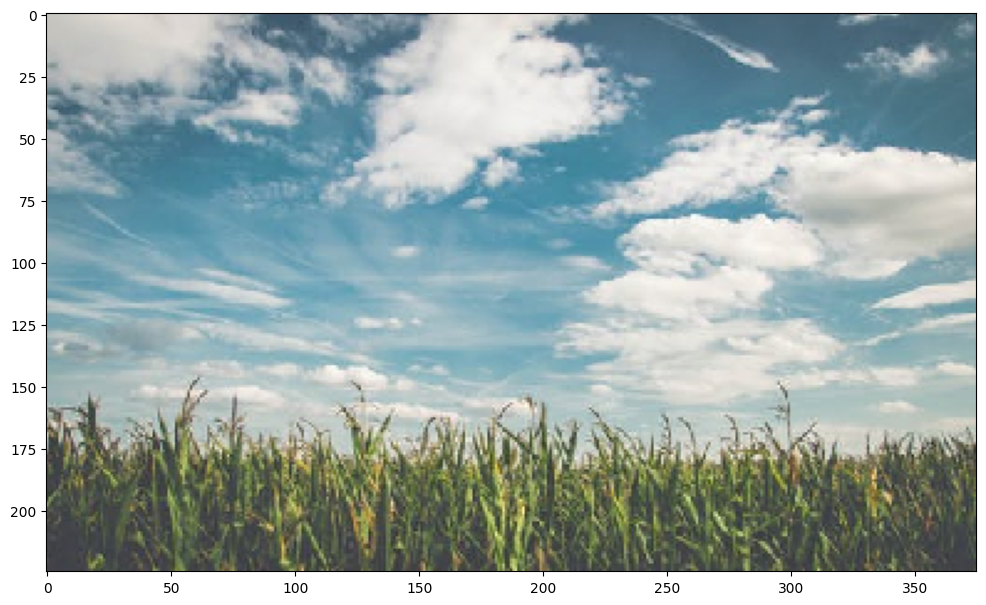

Step 0, loss 0.8320485353469849


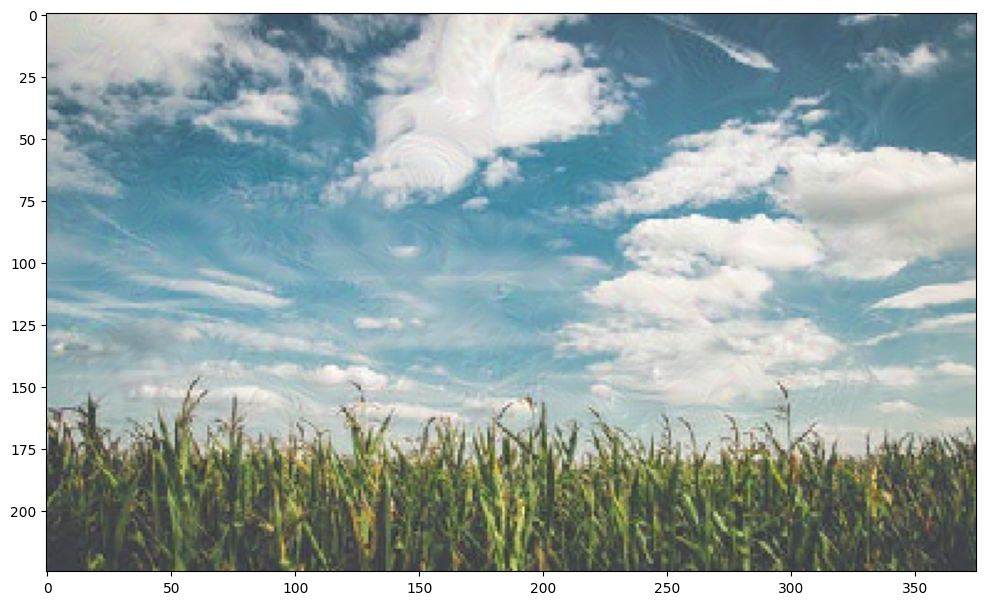

Step 100, loss 1.9138638973236084


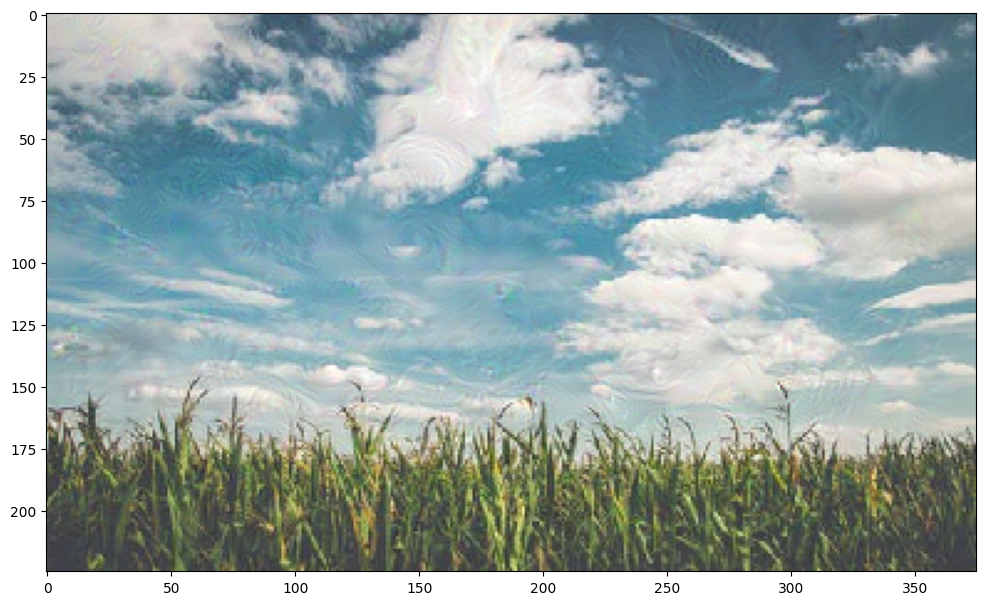

Step 200, loss 2.1815967559814453


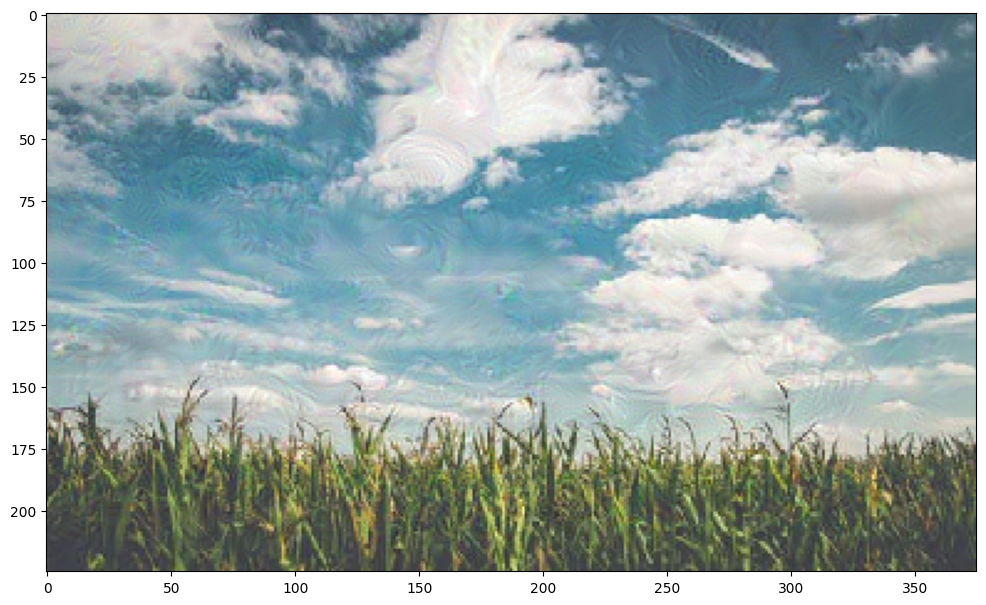

Step 300, loss 2.354830503463745


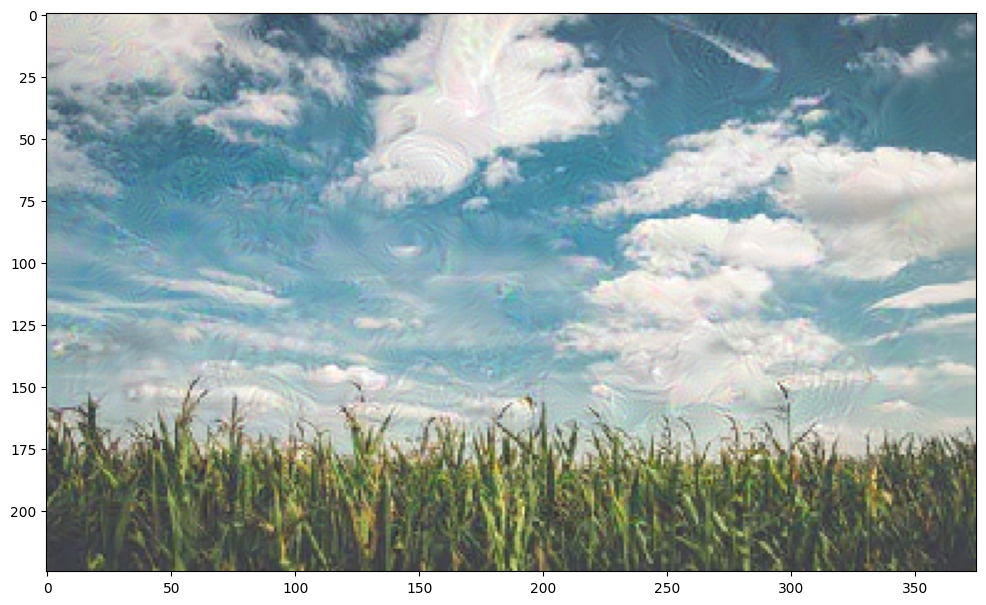

Step 400, loss 2.499260902404785


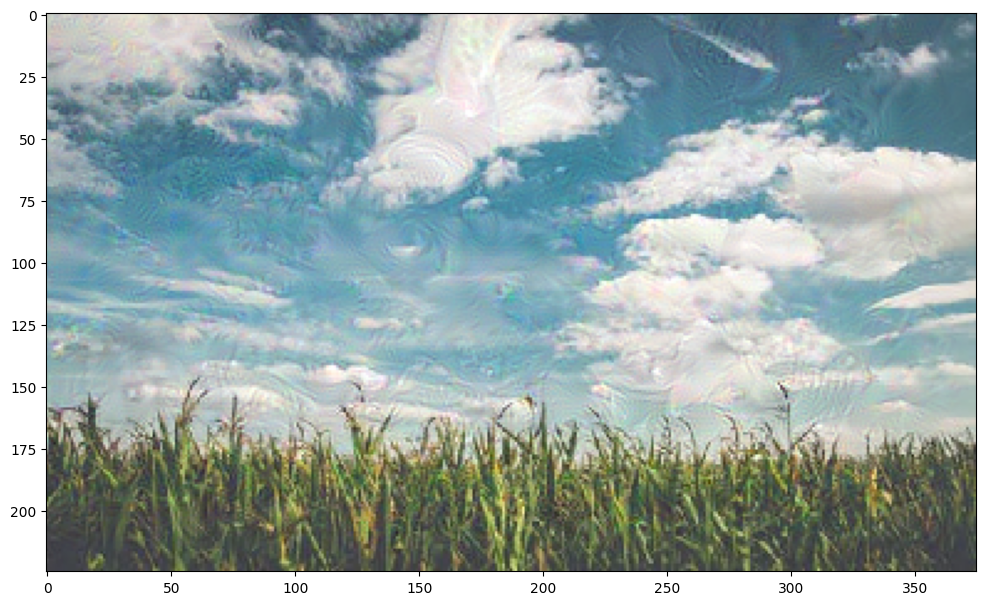

Step 500, loss 2.614130973815918


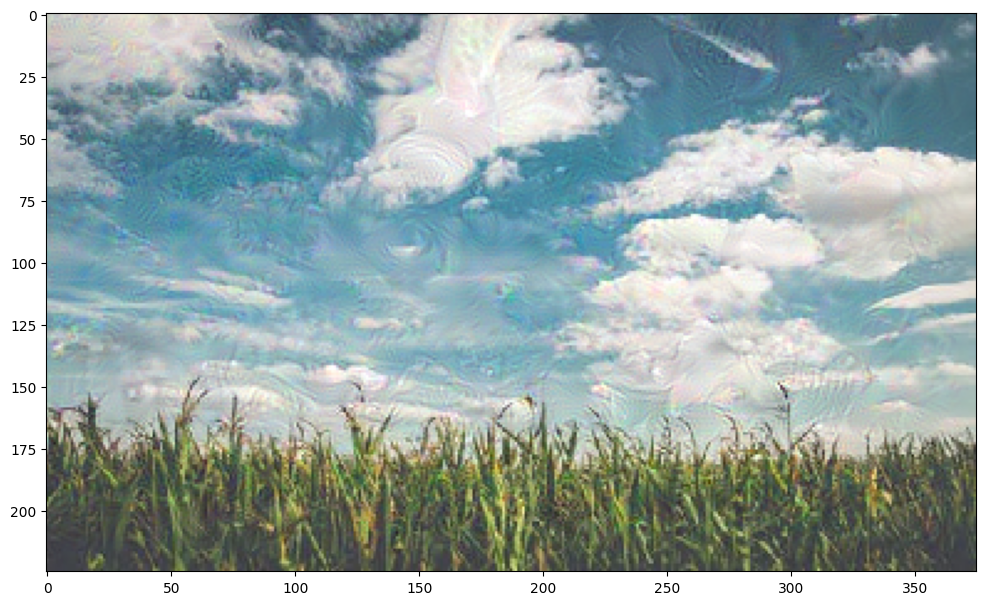

Step 600, loss 2.7059760093688965


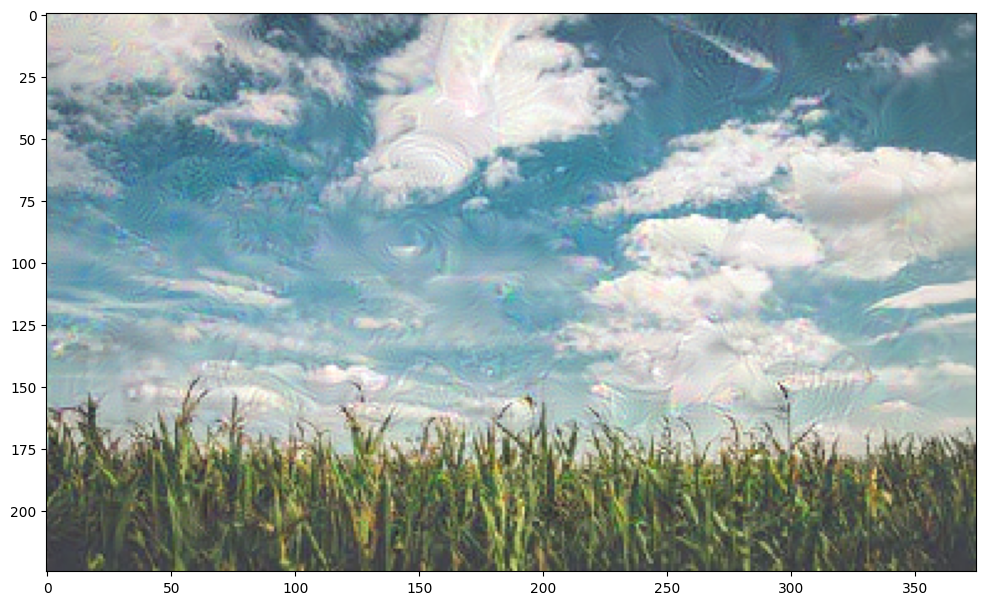

Step 700, loss 2.783160448074341


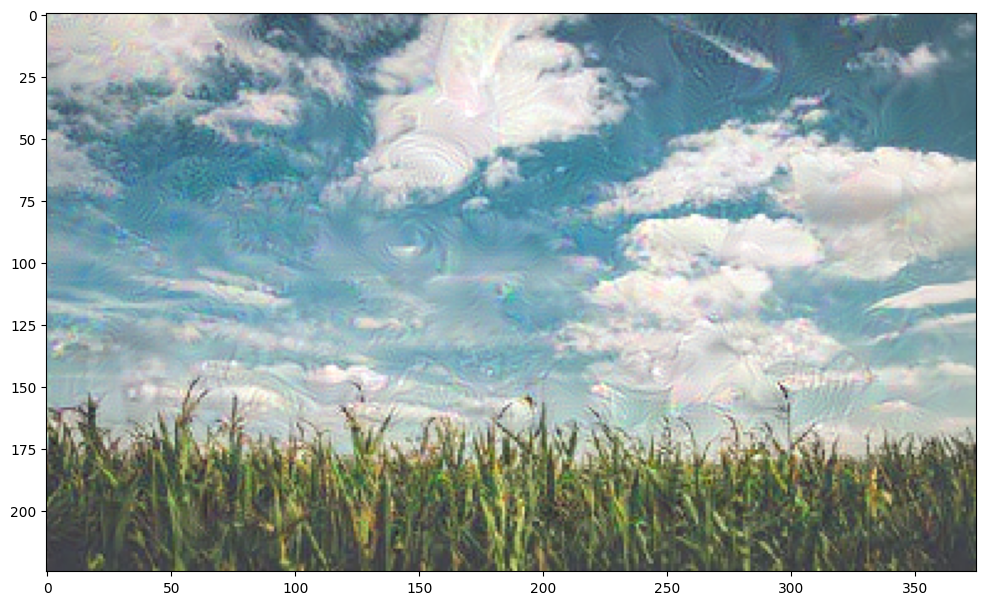

Step 800, loss 2.849006175994873


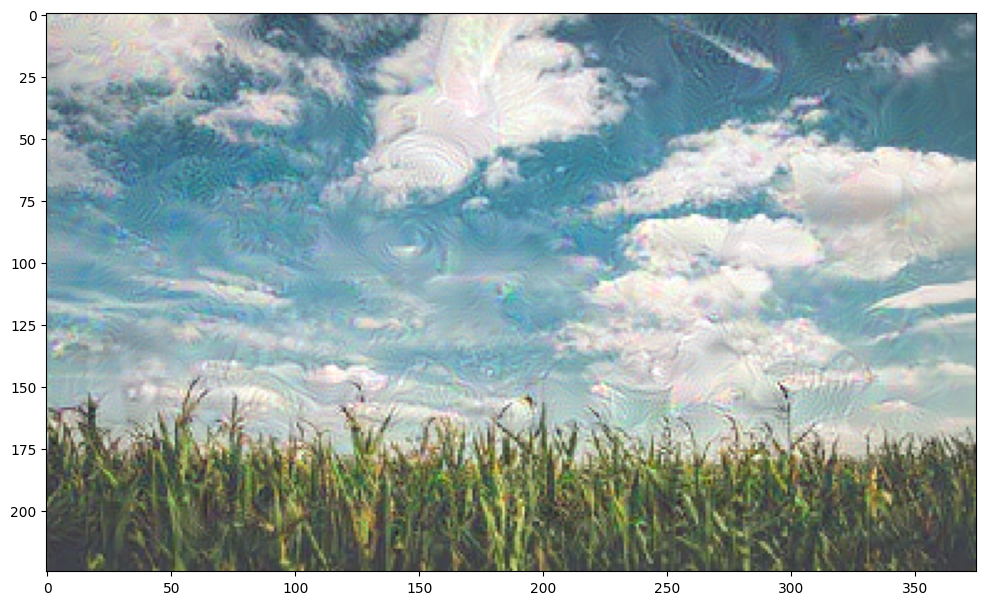

Step 900, loss 2.9045603275299072


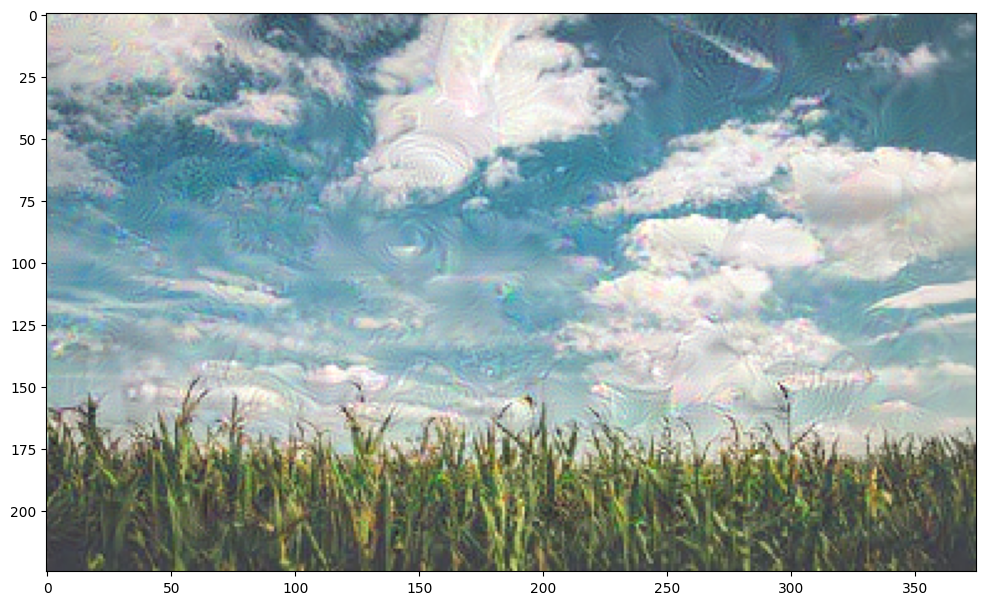

In [134]:
dream_img = run_deepdream_simple(model = deepdream_model, image = test_image, steps = 1000, step_size = 0.001)

# More dimensions

In [141]:
escala = 1.3

test_image2 = tf.keras.preprocessing.image.load_img(r'/content/sky.jpeg',
                                                     target_size = (225, 375))

#test_image2 = np.array(test_image2)
#test_image2 = tf.keras.applications.inception_v3.preprocess_input(test_image2)

image = tf.constant(np.array(test_image2))
base_shape = tf.cast(tf.shape(image)[:-1], tf.float32)


In [136]:
type(image)

tensorflow.python.framework.ops.EagerTensor

In [137]:
np.shape(image)

TensorShape([225, 375, 3])

In [138]:
type(base_shape)

tensorflow.python.framework.ops.EagerTensor

In [139]:
np.shape(base_shape)

TensorShape([2])

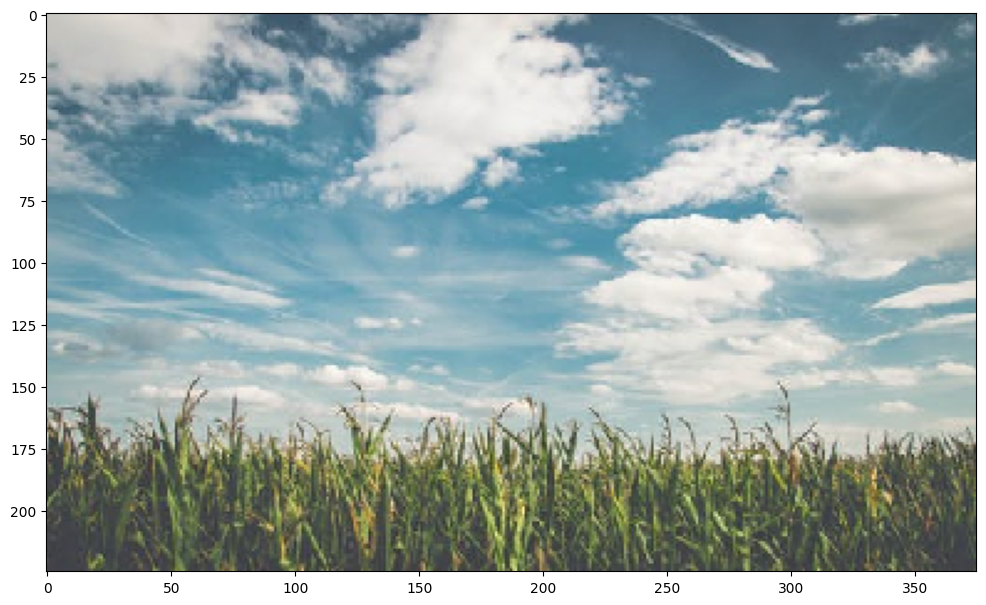

Step 0, loss 0.8320485353469849


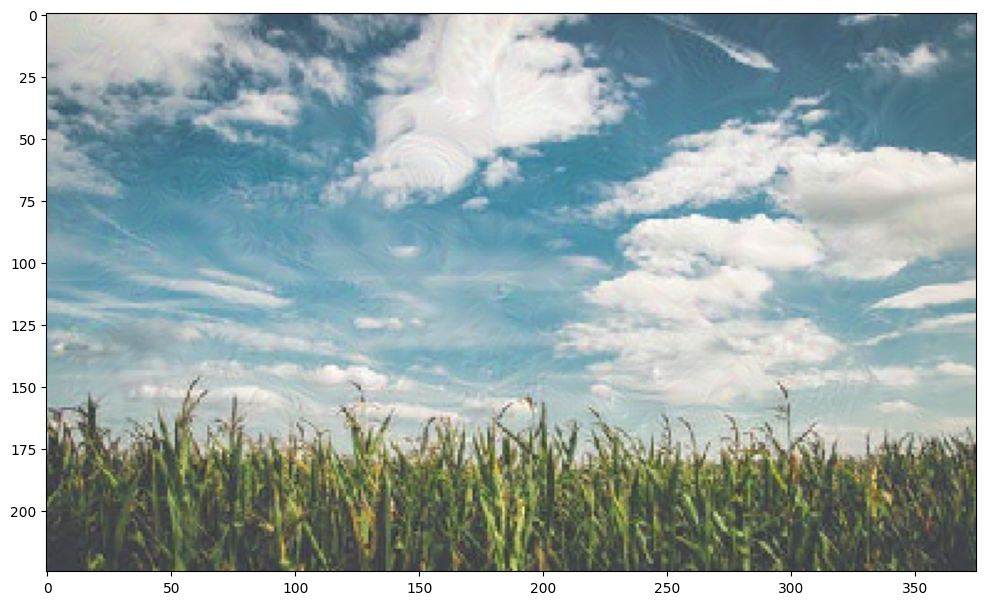

Step 100, loss 1.9138638973236084


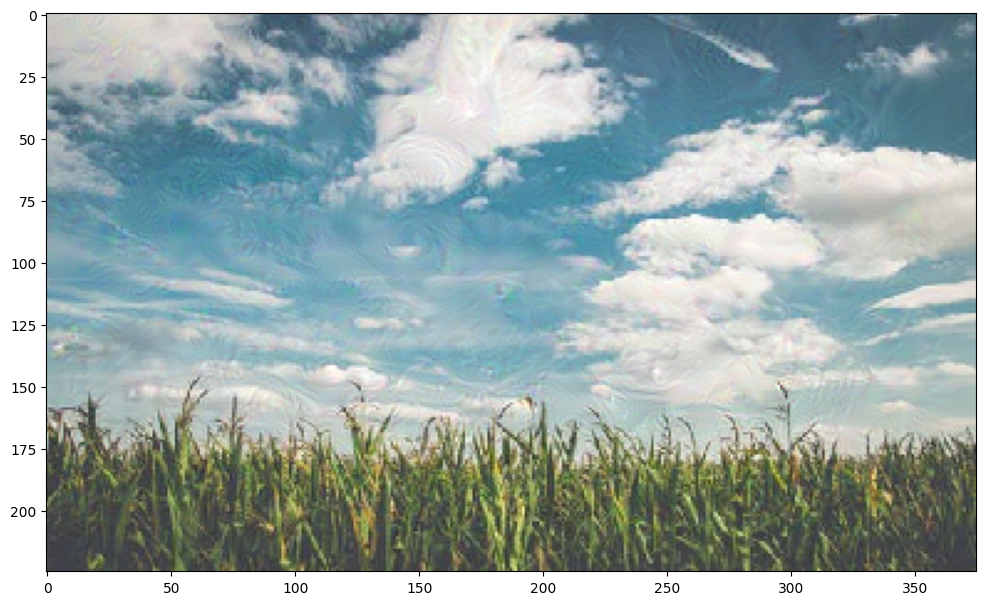

Step 200, loss 2.1815967559814453


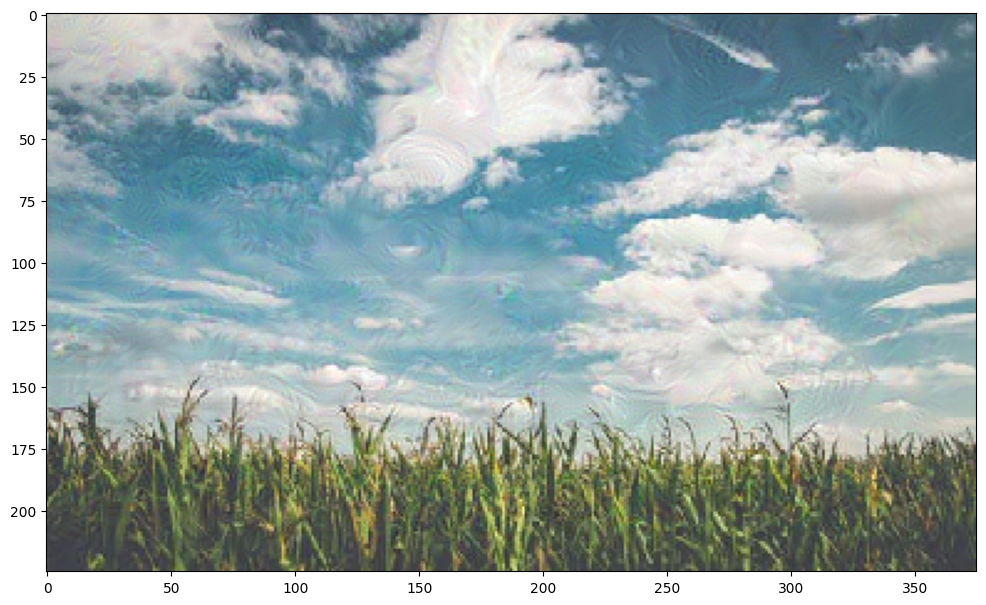

Step 300, loss 2.354830503463745


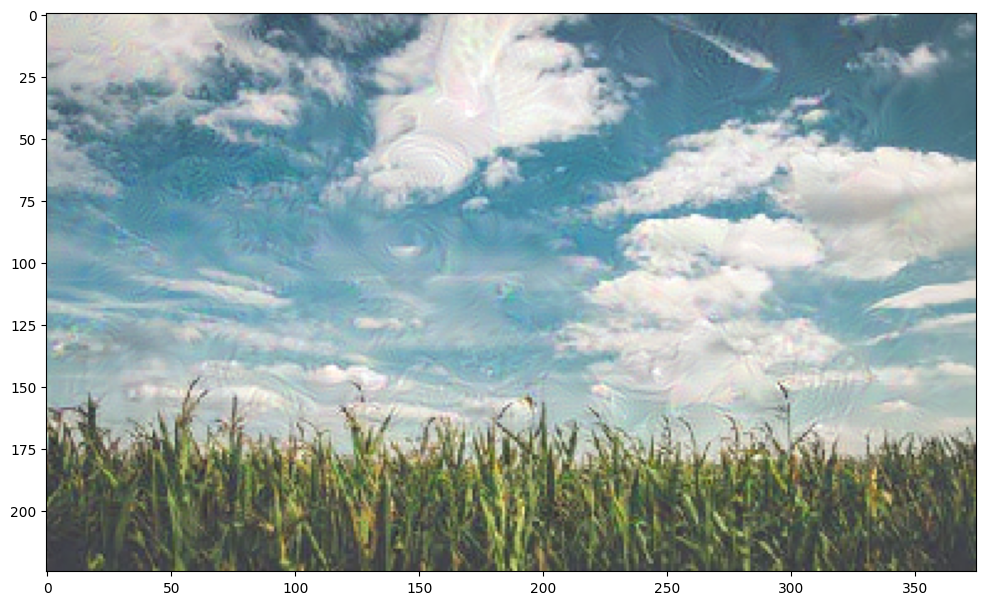

Lossess from multiple activatin layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>, <tf.Tensor 'Mean_3:0' shape=() dtype=float32>]
Sum of losses =  Tensor("Sum:0", shape=(), dtype=float32)


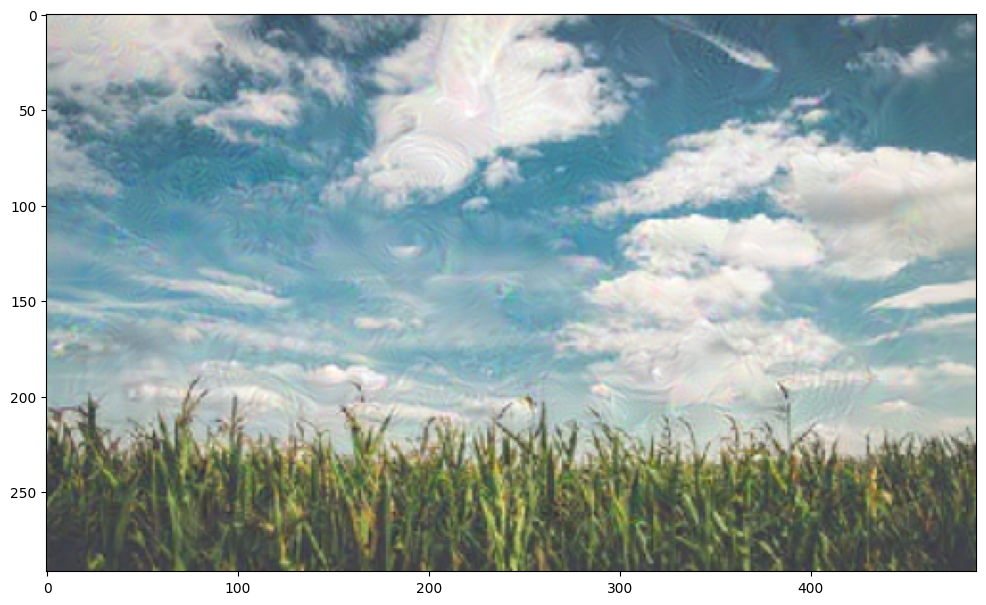

Step 0, loss 0.9463492631912231


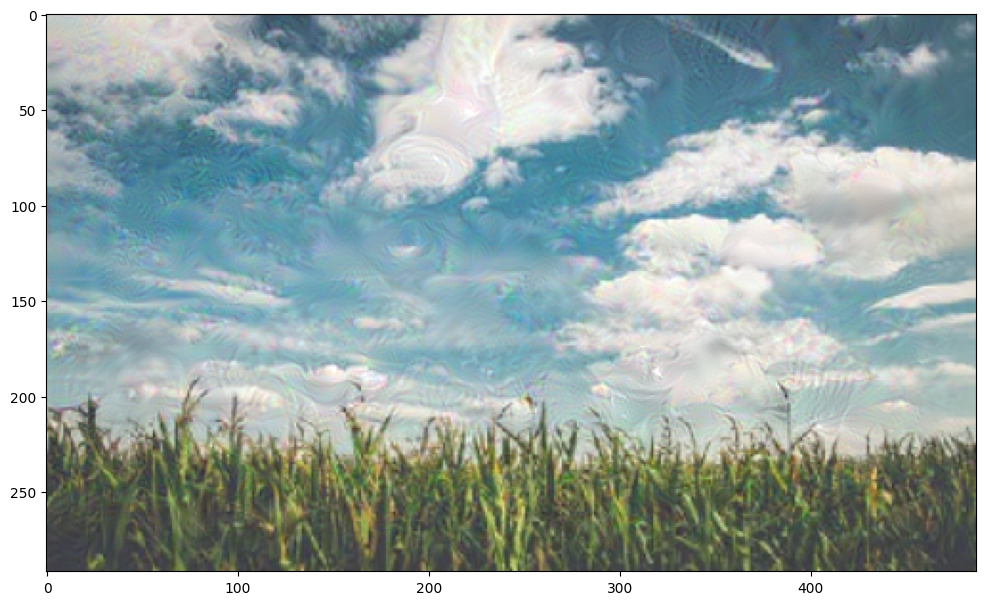

Step 100, loss 2.0013058185577393


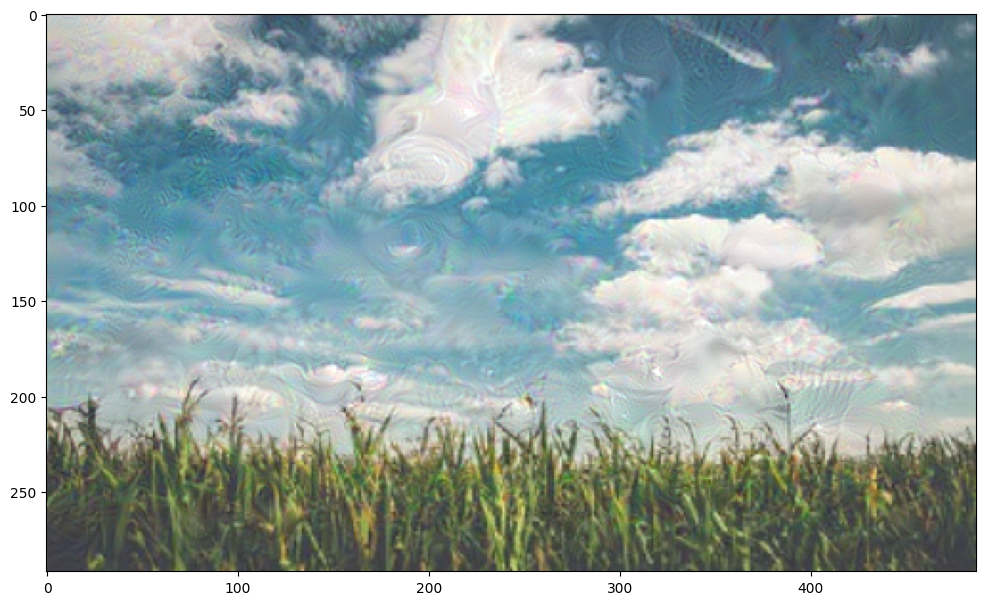

Step 200, loss 2.252098560333252


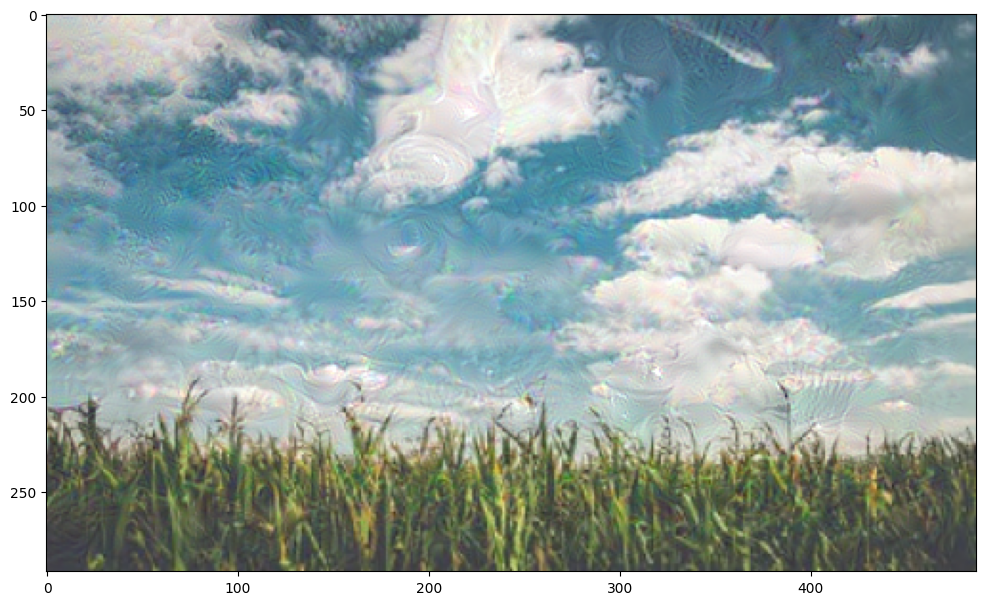

Step 300, loss 2.4123082160949707


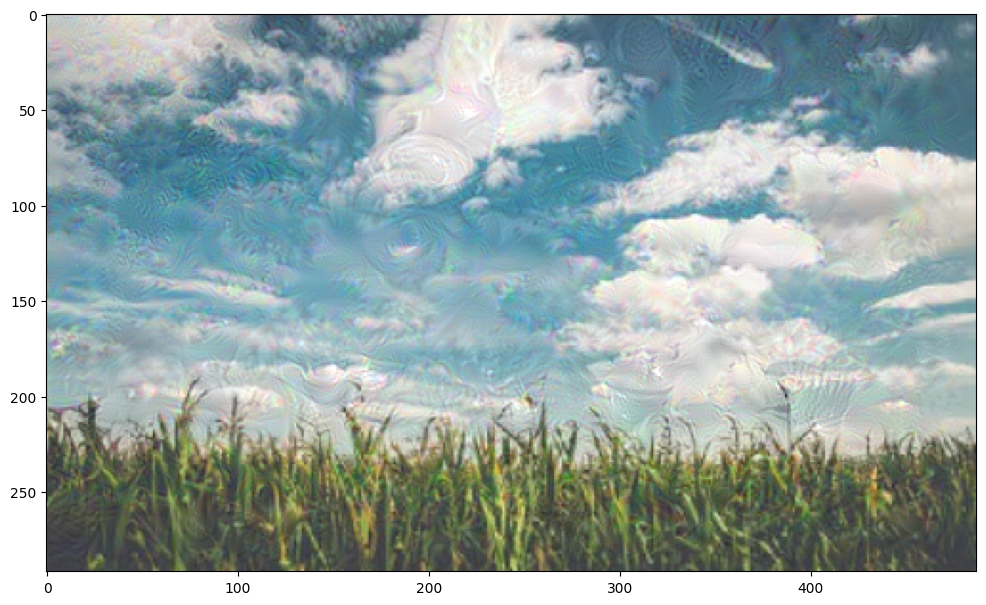

Lossess from multiple activatin layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>, <tf.Tensor 'Mean_3:0' shape=() dtype=float32>]
Sum of losses =  Tensor("Sum:0", shape=(), dtype=float32)


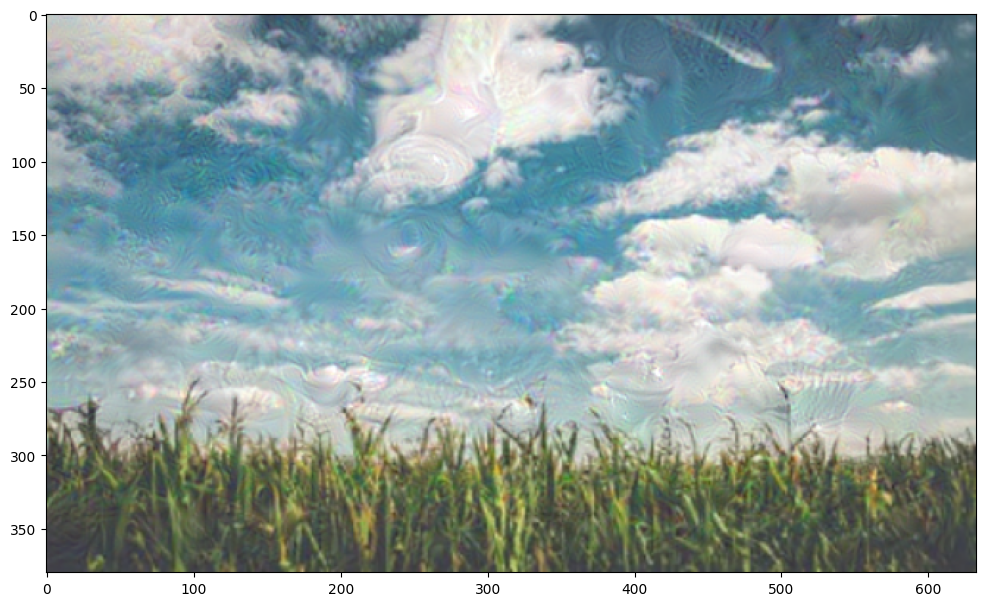

Step 0, loss 0.9458879232406616


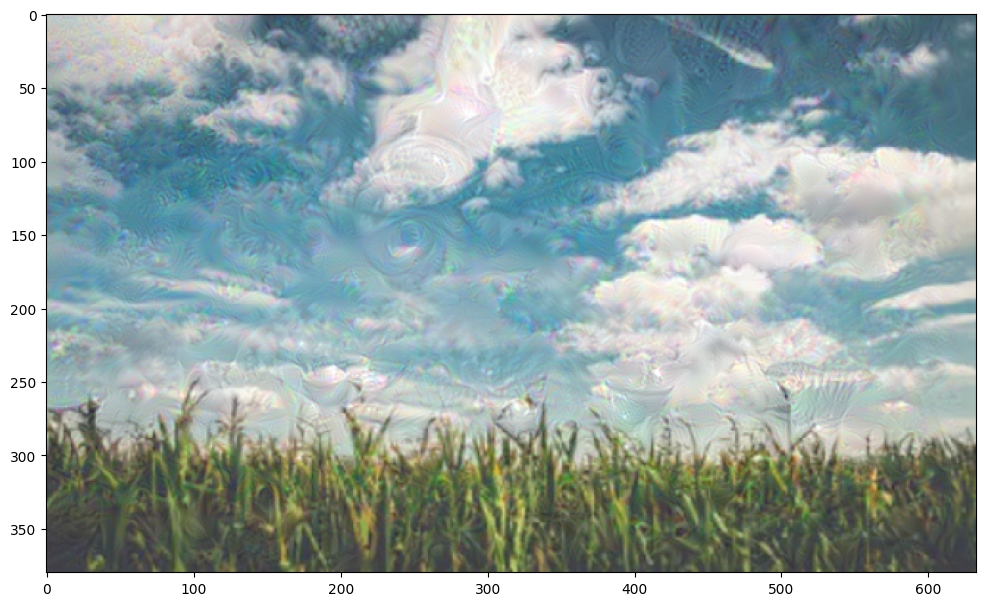

Step 100, loss 1.863718032836914


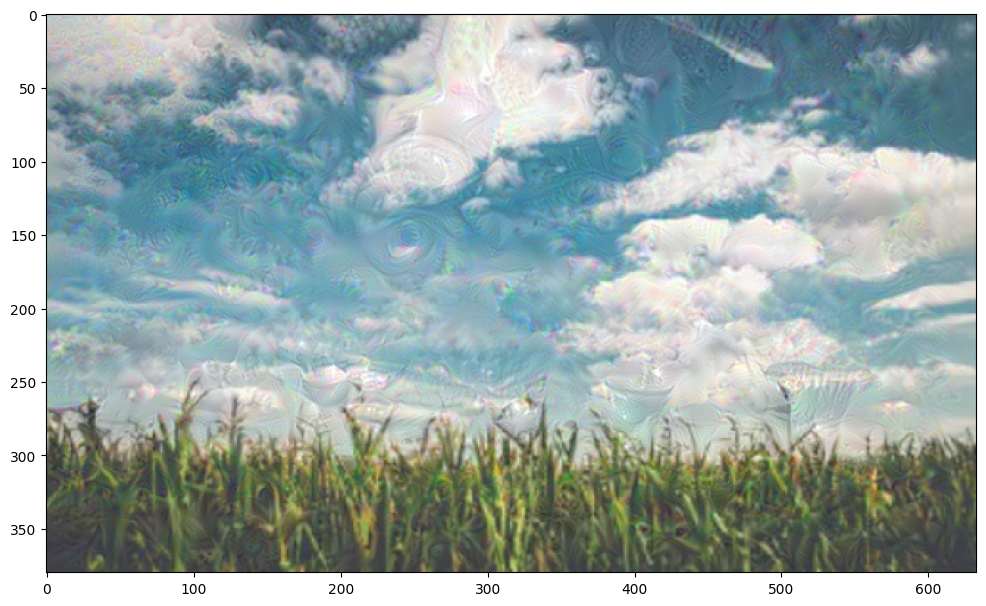

Step 200, loss 2.1057190895080566


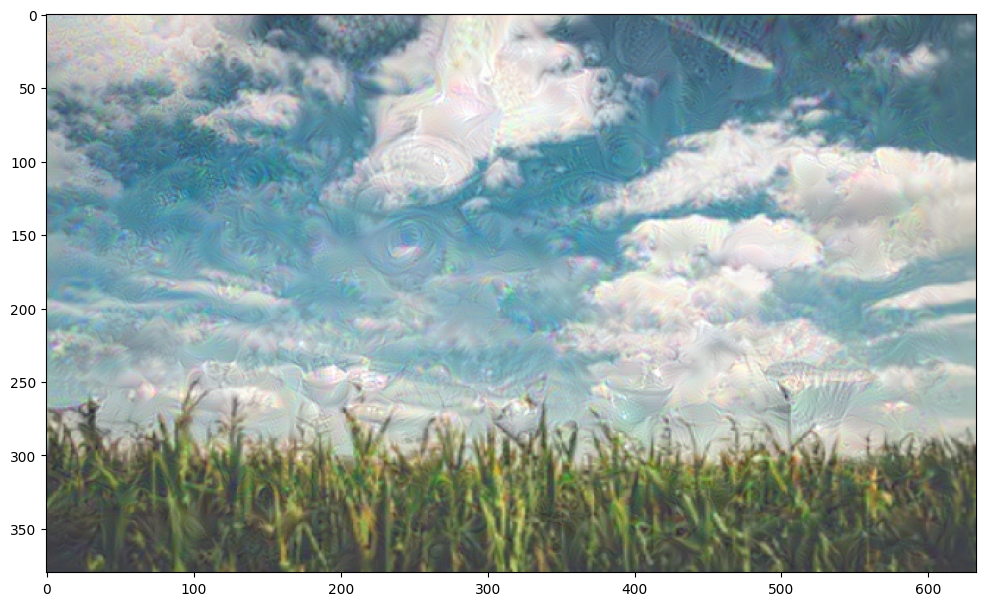

Step 300, loss 2.258768320083618


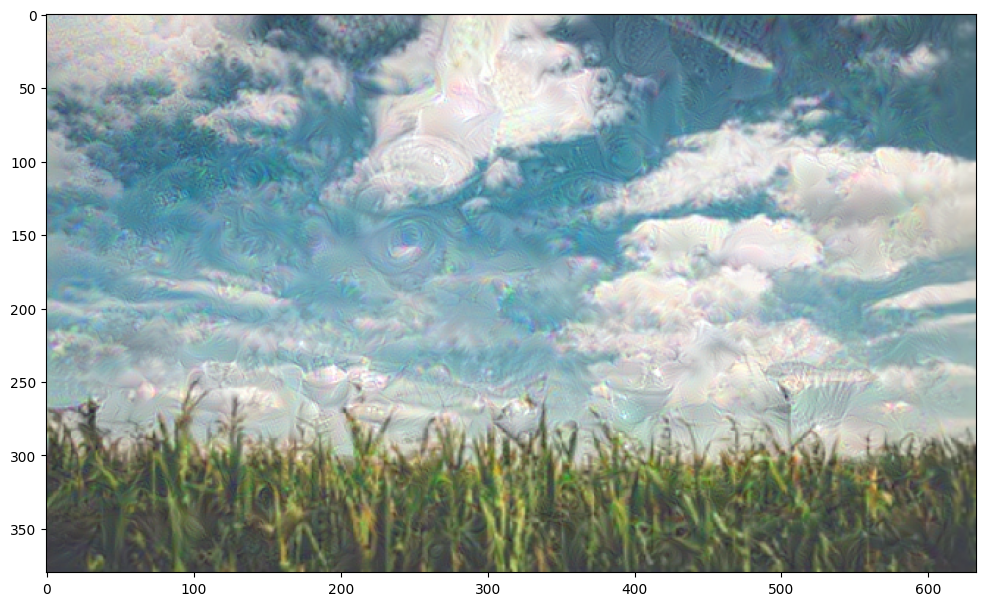

Lossess from multiple activatin layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>, <tf.Tensor 'Mean_3:0' shape=() dtype=float32>]
Sum of losses =  Tensor("Sum:0", shape=(), dtype=float32)


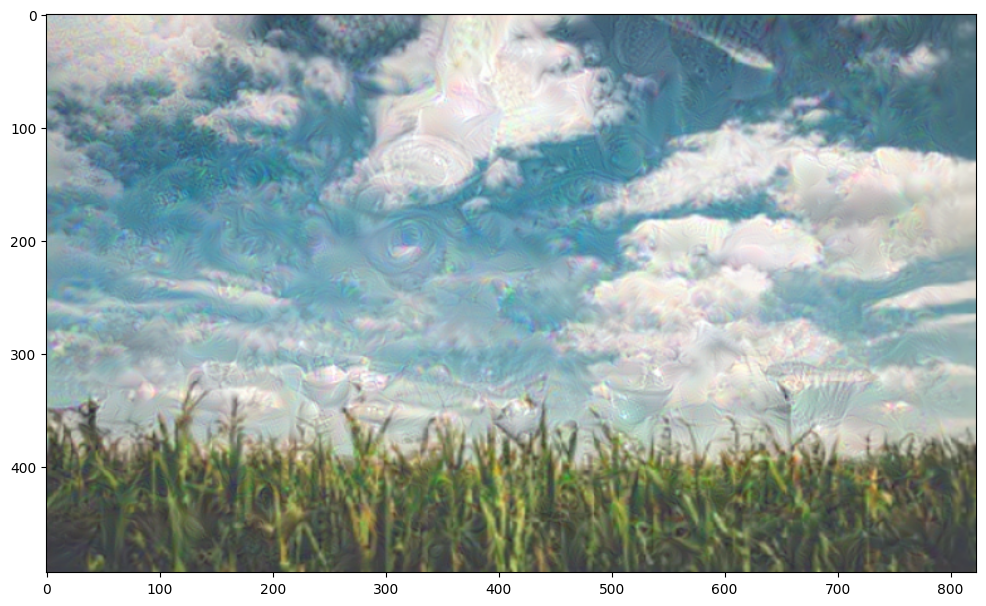

Step 0, loss 0.9150603413581848


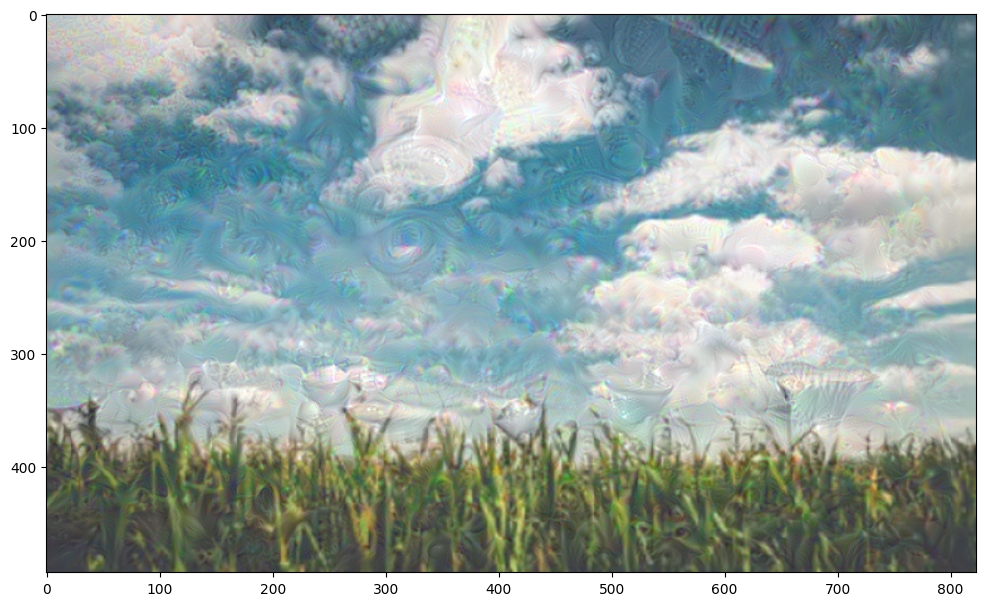

Step 100, loss 1.8437317609786987


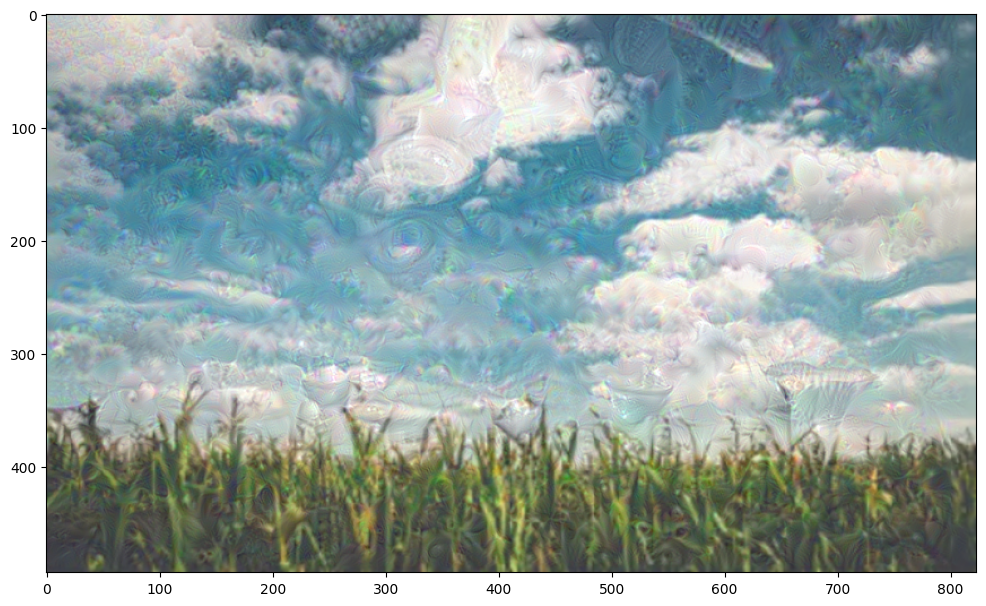

Step 200, loss 2.0773532390594482


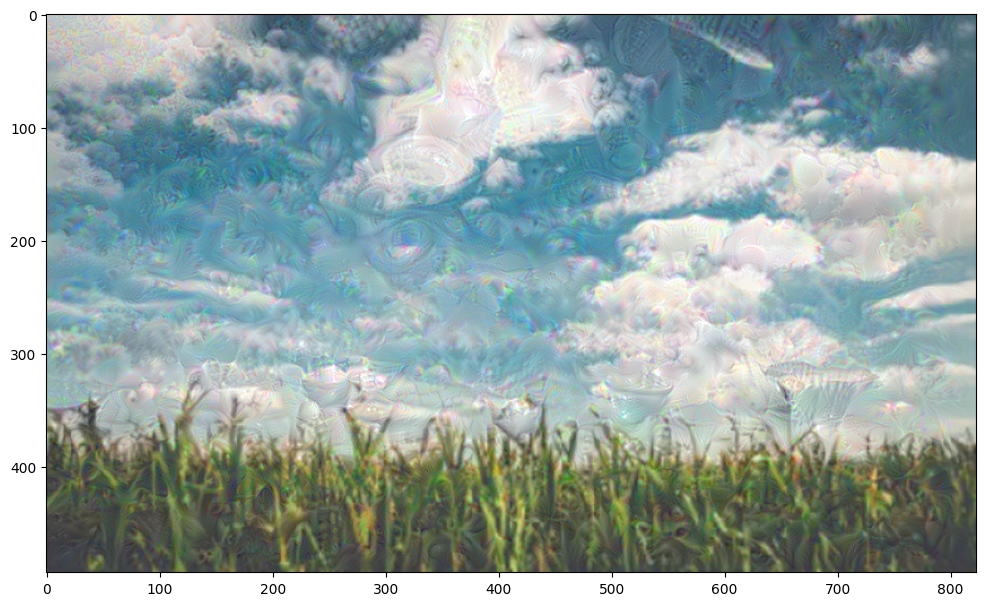

Step 300, loss 2.2206060886383057


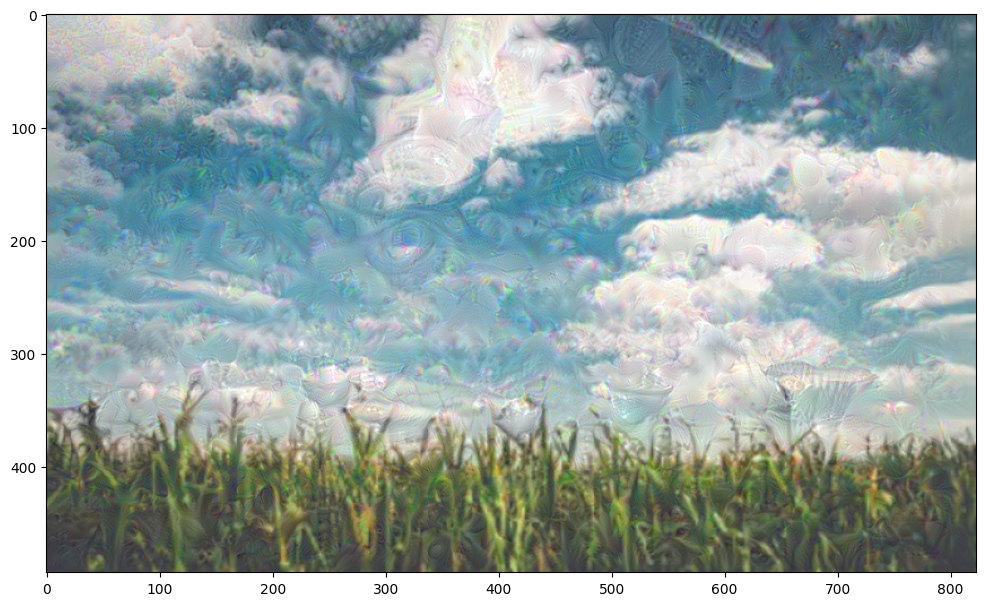

Lossess from multiple activatin layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>, <tf.Tensor 'Mean_3:0' shape=() dtype=float32>]
Sum of losses =  Tensor("Sum:0", shape=(), dtype=float32)


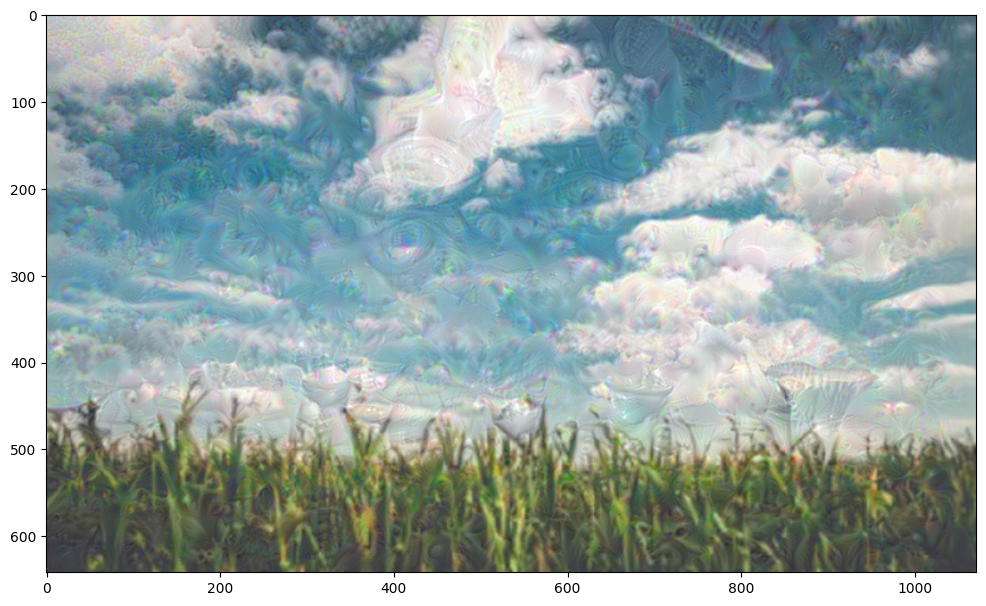

Step 0, loss 0.9055088758468628


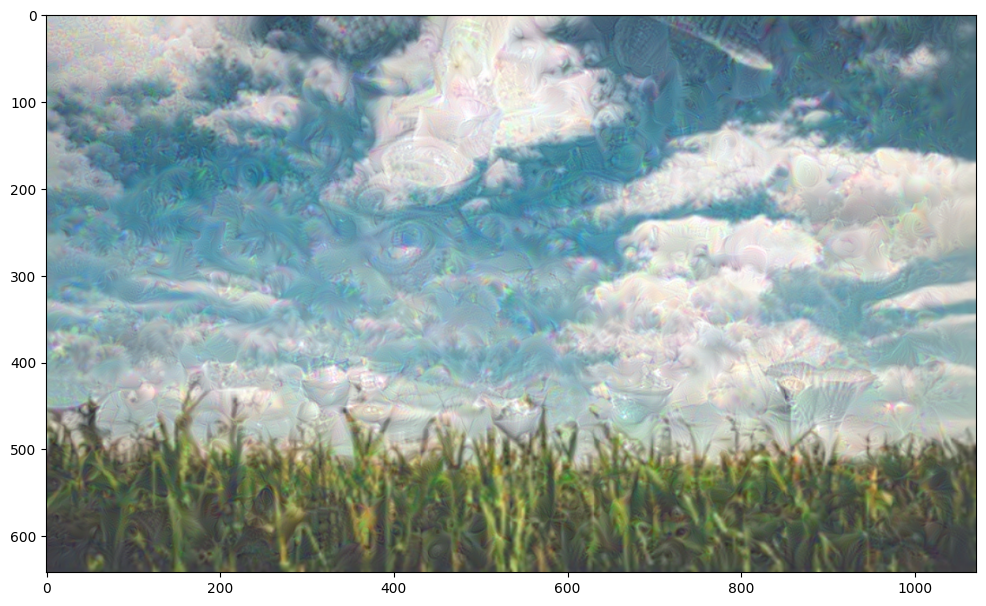

Step 100, loss 1.8784518241882324


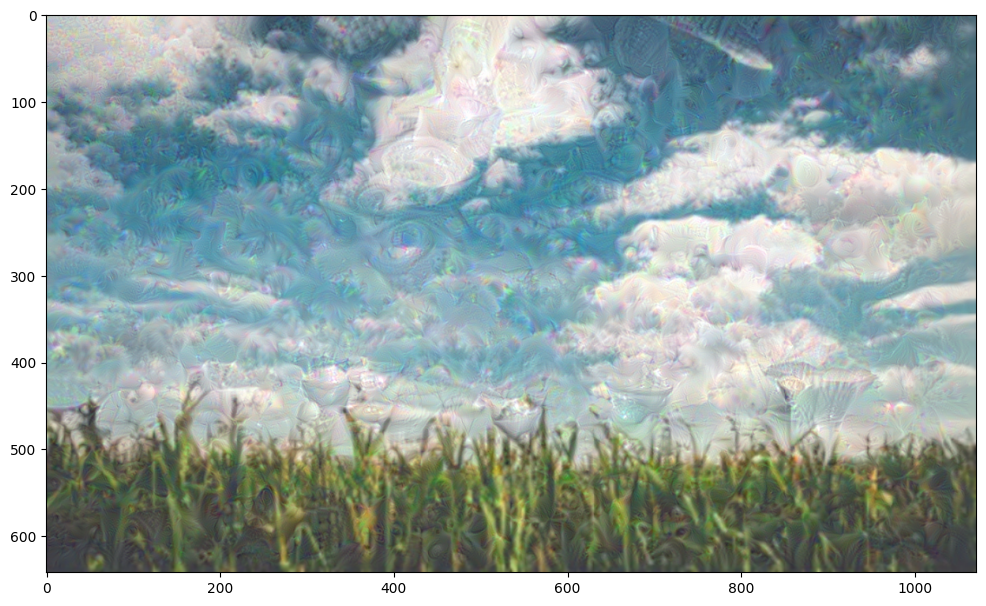

Step 200, loss 2.1235501766204834


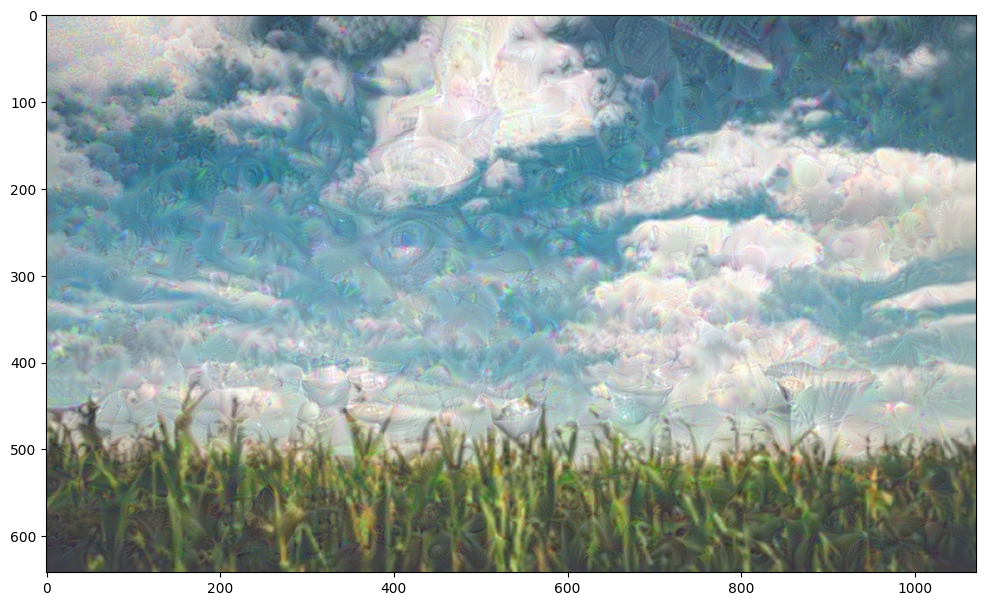

Step 300, loss 2.2802629470825195


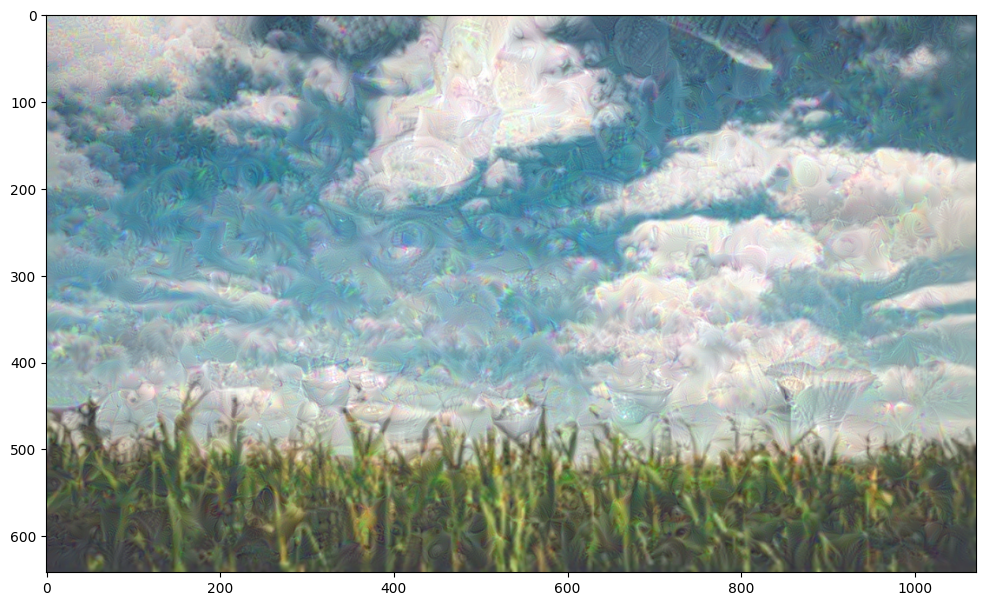

In [142]:
for n in range(5):
  new_shape  = tf.cast(base_shape * (escala ** n), tf.int32)
  image = tf.image.resize(image, new_shape)
  image = run_deepdream_simple(model = deepdream_model, image = image, steps = 400, step_size = 0.001)